In [1]:
using Pkg

In [2]:
ENV["PYTHON"] = "/home/tung/anaconda3/envs/celldancer/bin/python3"

"/home/tung/anaconda3/envs/celldancer/bin/python3"

In [3]:
Pkg.build("PyCall")

    Building Conda ─→ `~/.julia/scratchspaces/44cfe95a-1eb2-52ea-b672-e2afdf69b78f/b19db3927f0db4151cb86d073689f2428e524576/build.log`
    Building PyCall → `~/.julia/scratchspaces/44cfe95a-1eb2-52ea-b672-e2afdf69b78f/9816a3826b0ebf49ab4926e2b18842ad8b5c8f04/build.log`


In [4]:
using JuloVelo
using Plots

In [5]:
adata = read_adata("data/JuloVelo_pre.h5ad")

AnnData object 9815 ✕ 2000

In [6]:
adata.uns["iroot"] = 6

6

In [7]:
normalize(adata)

AnnData object 9815 ✕ 2000

In [8]:
filter_and_gene_kinetics_predetermination(adata; filter_criteria = 0.3)

[ Info: 1241 genes are filtered due to low correlation between norm_u and norm_s
[ Info: See adata.var[!, "bad_correlation_genes"] for details
[ Info: 414 genes are filtered due to bad kinetics
[ Info: See adata.var[!, "bad_kinetics_genes"] for details
[ Info: 345 genes are used to infer velocity
[ Info: See adata.var[!, "train_genes"] for details


AnnData object 9815 ✕ 2000

In [9]:
reshape_data(adata)

[ Info: Data is reshaped to (2, 9815, 345)


AnnData object 9815 ✕ 2000

In [10]:
Kinetics = build_velocity_model(adata)

[ Info: Successfully initialize velocity model


Chain(
  SpatialDense(2 => 100, depth = 345, leakyrelu),  # 103_500 parameters
  SpatialDense(100 => 100, depth = 345, leakyrelu),  # 3_484_500 parameters
  SpatialDense(100 => 3, depth = 345, σ),  # 104_535 parameters
)                   # Total: 6 arrays, 3_692_535 parameters, 14.086 MiB.

In [11]:
density_sampling(adata);

[ Info: Sample 2400 cells


In [12]:
train(adata, Kinetics)

[ Info: Training on gpu
[ Info: Training with Adam Optimizer
[ Info: TensorBoard logging at "/media/data/bmi111/KuanChiun/JuloVelo/thesis/results/erythroid/saves/"
[ Info: Start training


Epoch: 0  Train: (cos_loss = 21584.984f0, penalty = 1436.2743f0, AvgMeanCos = 0.9739f0)
Epoch: 1  Train: (cos_loss = 21476.924f0, penalty = 1436.1028f0, AvgMeanCos = 0.9741f0)
Epoch: 2  Train: (cos_loss = 21385.271f0, penalty = 1435.9302f0, AvgMeanCos = 0.9742f0)
Epoch: 3  Train: (cos_loss = 21300.82f0, penalty = 1435.7573f0, AvgMeanCos = 0.9743f0)
Epoch: 4  Train: (cos_loss = 21223.223f0, penalty = 1435.5844f0, AvgMeanCos = 0.9744f0)
Epoch: 5  Train: (cos_loss = 21153.965f0, penalty = 1435.4114f0, AvgMeanCos = 0.9745f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 6  Train: (cos_loss = 21092.98f0, penalty = 1435.2383f0, AvgMeanCos = 0.9745f0)
Epoch: 7  Train: (cos_loss = 21037.812f0, penalty = 1435.0648f0, AvgMeanCos = 0.9746f0)
Epoch: 8  Train: (cos_loss = 20987.688f0, penalty = 1434.8912f0, AvgMeanCos = 0.9747f0)
Epoch: 9  Train: (cos_loss = 20942.824f0, penalty = 1434.717f0, AvgMeanCos = 0.9747f0)
Epoch: 10  Train: (cos_loss = 20899.191f0, penalty = 1434.5428f0, AvgMeanCos = 0.9748f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 11  Train: (cos_loss = 20857.668f0, penalty = 1434.3685f0, AvgMeanCos = 0.9748f0)
Epoch: 12  Train: (cos_loss = 20818.54f0, penalty = 1434.1943f0, AvgMeanCos = 0.9749f0)
Epoch: 13  Train: (cos_loss = 20779.705f0, penalty = 1434.0195f0, AvgMeanCos = 0.9749f0)
Epoch: 14  Train: (cos_loss = 20741.02f0, penalty = 1433.8446f0, AvgMeanCos = 0.975f0)
Epoch: 15  Train: (cos_loss = 20705.93f0, penalty = 1433.6693f0, AvgMeanCos = 0.975f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 16  Train: (cos_loss = 20672.076f0, penalty = 1433.4932f0, AvgMeanCos = 0.975f0)
Epoch: 17  Train: (cos_loss = 20639.246f0, penalty = 1433.3168f0, AvgMeanCos = 0.9751f0)
Epoch: 18  Train: (cos_loss = 20606.922f0, penalty = 1433.1398f0, AvgMeanCos = 0.9751f0)
Epoch: 19  Train: (cos_loss = 20574.984f0, penalty = 1432.9625f0, AvgMeanCos = 0.9752f0)
Epoch: 20  Train: (cos_loss = 20544.1f0, penalty = 1432.7845f0, AvgMeanCos = 0.9752f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 21  Train: (cos_loss = 20514.39f0, penalty = 1432.6063f0, AvgMeanCos = 0.9752f0)
Epoch: 22  Train: (cos_loss = 20487.92f0, penalty = 1432.4276f0, AvgMeanCos = 0.9753f0)
Epoch: 23  Train: (cos_loss = 20462.95f0, penalty = 1432.2484f0, AvgMeanCos = 0.9753f0)
Epoch: 24  Train: (cos_loss = 20437.705f0, penalty = 1432.069f0, AvgMeanCos = 0.9753f0)
Epoch: 25  Train: (cos_loss = 20412.451f0, penalty = 1431.8889f0, AvgMeanCos = 0.9753f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 26  Train: (cos_loss = 20387.914f0, penalty = 1431.7086f0, AvgMeanCos = 0.9754f0)
Epoch: 27  Train: (cos_loss = 20364.61f0, penalty = 1431.5278f0, AvgMeanCos = 0.9754f0)
Epoch: 28  Train: (cos_loss = 20343.244f0, penalty = 1431.3467f0, AvgMeanCos = 0.9754f0)
Epoch: 29  Train: (cos_loss = 20322.883f0, penalty = 1431.165f0, AvgMeanCos = 0.9755f0)
Epoch: 30  Train: (cos_loss = 20303.156f0, penalty = 1430.983f0, AvgMeanCos = 0.9755f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 31  Train: (cos_loss = 20284.238f0, penalty = 1430.8007f0, AvgMeanCos = 0.9755f0)
Epoch: 32  Train: (cos_loss = 20265.146f0, penalty = 1430.6179f0, AvgMeanCos = 0.9755f0)
Epoch: 33  Train: (cos_loss = 20247.24f0, penalty = 1430.4349f0, AvgMeanCos = 0.9755f0)
Epoch: 34  Train: (cos_loss = 20229.68f0, penalty = 1430.2517f0, AvgMeanCos = 0.9756f0)
Epoch: 35  Train: (cos_loss = 20211.396f0, penalty = 1430.0684f0, AvgMeanCos = 0.9756f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 36  Train: (cos_loss = 20194.73f0, penalty = 1429.8845f0, AvgMeanCos = 0.9756f0)
Epoch: 37  Train: (cos_loss = 20178.092f0, penalty = 1429.7007f0, AvgMeanCos = 0.9756f0)
Epoch: 38  Train: (cos_loss = 20161.758f0, penalty = 1429.5167f0, AvgMeanCos = 0.9757f0)
Epoch: 39  Train: (cos_loss = 20145.982f0, penalty = 1429.3323f0, AvgMeanCos = 0.9757f0)
Epoch: 40  Train: (cos_loss = 20130.637f0, penalty = 1429.1478f0, AvgMeanCos = 0.9757f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 41  Train: (cos_loss = 20115.387f0, penalty = 1428.9629f0, AvgMeanCos = 0.9757f0)
Epoch: 42  Train: (cos_loss = 20100.09f0, penalty = 1428.7778f0, AvgMeanCos = 0.9757f0)
Epoch: 43  Train: (cos_loss = 20085.28f0, penalty = 1428.5927f0, AvgMeanCos = 0.9757f0)
Epoch: 44  Train: (cos_loss = 20070.682f0, penalty = 1428.4071f0, AvgMeanCos = 0.9758f0)
Epoch: 45  Train: (cos_loss = 20056.1f0, penalty = 1428.2214f0, AvgMeanCos = 0.9758f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 46  Train: (cos_loss = 20042.135f0, penalty = 1428.0354f0, AvgMeanCos = 0.9758f0)
Epoch: 47  Train: (cos_loss = 20028.61f0, penalty = 1427.8496f0, AvgMeanCos = 0.9758f0)
Epoch: 48  Train: (cos_loss = 20015.613f0, penalty = 1427.6636f0, AvgMeanCos = 0.9758f0)
Epoch: 49  Train: (cos_loss = 20002.318f0, penalty = 1427.477f0, AvgMeanCos = 0.9758f0)
Epoch: 50  Train: (cos_loss = 19989.152f0, penalty = 1427.2906f0, AvgMeanCos = 0.9759f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 51  Train: (cos_loss = 19976.795f0, penalty = 1427.1039f0, AvgMeanCos = 0.9759f0)
Epoch: 52  Train: (cos_loss = 19964.918f0, penalty = 1426.9172f0, AvgMeanCos = 0.9759f0)
Epoch: 53  Train: (cos_loss = 19953.746f0, penalty = 1426.7299f0, AvgMeanCos = 0.9759f0)
Epoch: 54  Train: (cos_loss = 19942.725f0, penalty = 1426.5427f0, AvgMeanCos = 0.9759f0)
Epoch: 55  Train: (cos_loss = 19932.426f0, penalty = 1426.3553f0, AvgMeanCos = 0.9759f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 56  Train: (cos_loss = 19922.771f0, penalty = 1426.1677f0, AvgMeanCos = 0.9759f0)
Epoch: 57  Train: (cos_loss = 19912.828f0, penalty = 1425.9801f0, AvgMeanCos = 0.976f0)
Epoch: 58  Train: (cos_loss = 19902.633f0, penalty = 1425.7926f0, AvgMeanCos = 0.976f0)
Epoch: 59  Train: (cos_loss = 19893.607f0, penalty = 1425.605f0, AvgMeanCos = 0.976f0)
Epoch: 60  Train: (cos_loss = 19885.004f0, penalty = 1425.4174f0, AvgMeanCos = 0.976f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 61  Train: (cos_loss = 19875.863f0, penalty = 1425.2295f0, AvgMeanCos = 0.976f0)
Epoch: 62  Train: (cos_loss = 19865.908f0, penalty = 1425.0413f0, AvgMeanCos = 0.976f0)
Epoch: 63  Train: (cos_loss = 19855.924f0, penalty = 1424.8533f0, AvgMeanCos = 0.976f0)
Epoch: 64  Train: (cos_loss = 19847.326f0, penalty = 1424.6652f0, AvgMeanCos = 0.976f0)
Epoch: 65  Train: (cos_loss = 19838.43f0, penalty = 1424.4769f0, AvgMeanCos = 0.976f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 66  Train: (cos_loss = 19829.973f0, penalty = 1424.2886f0, AvgMeanCos = 0.9761f0)
Epoch: 67  Train: (cos_loss = 19821.748f0, penalty = 1424.1005f0, AvgMeanCos = 0.9761f0)
Epoch: 68  Train: (cos_loss = 19813.602f0, penalty = 1423.9119f0, AvgMeanCos = 0.9761f0)
Epoch: 69  Train: (cos_loss = 19805.838f0, penalty = 1423.7234f0, AvgMeanCos = 0.9761f0)
Epoch: 70  Train: (cos_loss = 19798.094f0, penalty = 1423.5353f0, AvgMeanCos = 0.9761f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 71  Train: (cos_loss = 19790.436f0, penalty = 1423.3467f0, AvgMeanCos = 0.9761f0)
Epoch: 72  Train: (cos_loss = 19782.887f0, penalty = 1423.1583f0, AvgMeanCos = 0.9761f0)
Epoch: 73  Train: (cos_loss = 19775.367f0, penalty = 1422.9701f0, AvgMeanCos = 0.9761f0)
Epoch: 74  Train: (cos_loss = 19768.21f0, penalty = 1422.7817f0, AvgMeanCos = 0.9761f0)
Epoch: 75  Train: (cos_loss = 19760.846f0, penalty = 1422.5933f0, AvgMeanCos = 0.9761f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 76  Train: (cos_loss = 19753.861f0, penalty = 1422.405f0, AvgMeanCos = 0.9761f0)
Epoch: 77  Train: (cos_loss = 19746.727f0, penalty = 1422.2166f0, AvgMeanCos = 0.9762f0)
Epoch: 78  Train: (cos_loss = 19740.166f0, penalty = 1422.0283f0, AvgMeanCos = 0.9762f0)
Epoch: 79  Train: (cos_loss = 19734.06f0, penalty = 1421.8397f0, AvgMeanCos = 0.9762f0)
Epoch: 80  Train: (cos_loss = 19728.14f0, penalty = 1421.6514f0, AvgMeanCos = 0.9762f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 81  Train: (cos_loss = 19722.16f0, penalty = 1421.4628f0, AvgMeanCos = 0.9762f0)
Epoch: 82  Train: (cos_loss = 19716.664f0, penalty = 1421.2744f0, AvgMeanCos = 0.9762f0)
Epoch: 83  Train: (cos_loss = 19711.434f0, penalty = 1421.0859f0, AvgMeanCos = 0.9762f0)
Epoch: 84  Train: (cos_loss = 19706.277f0, penalty = 1420.8975f0, AvgMeanCos = 0.9762f0)
Epoch: 85  Train: (cos_loss = 19700.914f0, penalty = 1420.709f0, AvgMeanCos = 0.9762f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 86  Train: (cos_loss = 19695.71f0, penalty = 1420.5208f0, AvgMeanCos = 0.9762f0)
Epoch: 87  Train: (cos_loss = 19690.922f0, penalty = 1420.3322f0, AvgMeanCos = 0.9762f0)
Epoch: 88  Train: (cos_loss = 19685.84f0, penalty = 1420.1438f0, AvgMeanCos = 0.9762f0)
Epoch: 89  Train: (cos_loss = 19681.203f0, penalty = 1419.9557f0, AvgMeanCos = 0.9762f0)
Epoch: 90  Train: (cos_loss = 19676.379f0, penalty = 1419.7673f0, AvgMeanCos = 0.9762f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 91  Train: (cos_loss = 19671.592f0, penalty = 1419.5792f0, AvgMeanCos = 0.9762f0)
Epoch: 92  Train: (cos_loss = 19667.02f0, penalty = 1419.3909f0, AvgMeanCos = 0.9762f0)
Epoch: 93  Train: (cos_loss = 19662.613f0, penalty = 1419.2025f0, AvgMeanCos = 0.9763f0)
Epoch: 94  Train: (cos_loss = 19658.227f0, penalty = 1419.0143f0, AvgMeanCos = 0.9763f0)
Epoch: 95  Train: (cos_loss = 19654.043f0, penalty = 1418.8258f0, AvgMeanCos = 0.9763f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 96  Train: (cos_loss = 19649.875f0, penalty = 1418.6376f0, AvgMeanCos = 0.9763f0)
Epoch: 97  Train: (cos_loss = 19645.602f0, penalty = 1418.4493f0, AvgMeanCos = 0.9763f0)
Epoch: 98  Train: (cos_loss = 19640.902f0, penalty = 1418.2611f0, AvgMeanCos = 0.9763f0)
Epoch: 99  Train: (cos_loss = 19636.293f0, penalty = 1418.0729f0, AvgMeanCos = 0.9763f0)
Epoch: 100  Train: (cos_loss = 19632.264f0, penalty = 1417.8845f0, AvgMeanCos = 0.9763f0)


[ Info: Model is saved in saves/Kinetics.bson


Chain(
  SpatialDense(2 => 100, depth = 345, leakyrelu),  # 103_500 parameters
  SpatialDense(100 => 100, depth = 345, leakyrelu),  # 3_484_500 parameters
  SpatialDense(100 => 3, depth = 345, σ),  # 104_535 parameters
)                   # Total: 6 arrays, 3_692_535 parameters, 14.086 MiB.

In [13]:
velocity_estimation(adata, Kinetics);

[ Info: Velocity saved in adata.uns["velocity"]
[ Info: kinetics saved in adata.uns["kinetics"]


In [14]:
compute_cell_velocity(adata);

In [15]:
estimate_pseudotime(adata, 3, n_repeat = 3, celltype = "celltype");

[ Info: Start estimate pseudotime, it may take a long time.
Generating Trajectories: 100%|████████| 29445/29445 [00:01<00:00, 17420.40it/s]


Pseudo random number generator seeds are set to:  [0, 1, 2]
There are 3 clusters.
[0 1 2]
--- 51.26500058174133 seconds ---


In [16]:
write_adata(adata, filename = "data/JuloVelo")

# Plot figure

## Gene kinetics

In [17]:
palattes = Dict("Blood progenitors 1"=>"#f9decf", 
    "Blood progenitors 2"=>"#c9a997", 
    "Erythroid1"=>"#C72228", 
    "Erythroid2"=>"#f79083", 
    "Erythroid3"=>"#EF4E22"
)

Dict{String, String} with 5 entries:
  "Erythroid1"          => "#C72228"
  "Erythroid3"          => "#EF4E22"
  "Erythroid2"          => "#f79083"
  "Blood progenitors 1" => "#f9decf"
  "Blood progenitors 2" => "#c9a997"

In [18]:
function gene_plot(x, x̂; part = 20)
    x_range = Array(range(0, 1, part))
    y_range = Array(range(0, 1, part))
    
    arrow_vector = Array{Float32}(undef, 0, 2)
    point_vector = Array{Float32}(undef, 0, 2)
    
    for i in 1:part - 1
        for j in 1:part - 1
            index = intersect(findall(k -> (k .>= x_range[i]) & (k .<= x_range[i + 1]), x[2, :]), 
            findall(k -> (k .>= y_range[j]) & (k .<= y_range[j + 1]), x[1, :]))
            
            if length(index) > 0
                selected = x̂[:, index]
            else
                continue
            end
            
            selected_vector = sum(selected, dims = 2) ./ size(selected, 2)
            scale = maximum(abs, selected_vector) / (x_range[i + 1] - x_range[i])
            selected_vector = selected_vector ./ scale
            #println(selected_vector)
            xcenter = (x_range[i + 1] + x_range[i]) / 2
            ycenter = (y_range[j + 1] + y_range[j]) / 2
            xarrow = selected_vector[2]
            yarrow = selected_vector[1]
            
            arrow_vector = vcat(arrow_vector, vec([xarrow, yarrow])')
            point_vector = vcat(point_vector, vec([xcenter, ycenter])')
        end
    end
    
    return arrow_vector, point_vector
end

gene_plot (generic function with 1 method)

In [19]:
theme(:vibrant, framestyle = :zerolines, grid = true, markersize = 3, linewidth = 1.4, palette = :tab20) 

In [20]:
GR.setarrowsize(0.5)

In [21]:
X = adata.uns["X"];
velocity = adata.uns["velocity"]
genes = adata.var_names[adata.var[!, "train_genes"]]
celltype = adata.obs[!, "celltype"]
labels = sort(unique(celltype));

In [22]:
idx = findfirst(x -> x == "Hba-x", genes)

57

In [23]:
arrow_vector, point_vector = gene_plot(X[:, :, idx], velocity[:, :, idx])

([0.0017448253873107986 0.05263157894736842; 0.027030239724918678 0.05263157894736842; … ; 0.05263157894736847 0.040941102420119134; 0.052631578947368474 0.03451229640476965], [0.02631578947368421 0.02631578947368421; 0.02631578947368421 0.07894736842105263; … ; 0.9736842105263157 0.868421052631579; 0.9736842105263157 0.9210526315789473])

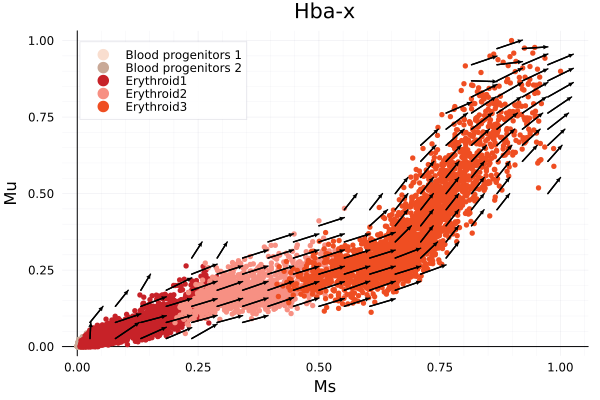

In [24]:
p1 = plot()
for label in labels
    scatter!(X[2, celltype .== label, idx], X[1, celltype .== label, idx], label = label, xlabel = "Ms", ylabel = "Mu", title = "Hba-x", color = palattes[label])
end
quiver!(point_vector[:, 1], point_vector[:, 2], quiver = (arrow_vector[:, 1], arrow_vector[:, 2]), arrow = arrow(:closed), color = "#000000")

In [25]:
idx2 = findfirst(x -> x == "Rspo3", genes)

19

In [26]:
arrow_vector1, point_vector1 = gene_plot(X[:, :, idx2], velocity[:, :, idx2])

([-0.004890404300394794 -0.05263157894736842; 0.03405256190715771 -0.05263157894736842; … ; -0.0019104082399712015 -0.05263157894736836; -0.014755706451569525 -0.052631578947368474], [0.02631578947368421 0.02631578947368421; 0.02631578947368421 0.07894736842105263; … ; 0.9210526315789473 0.868421052631579; 0.9736842105263157 0.763157894736842])

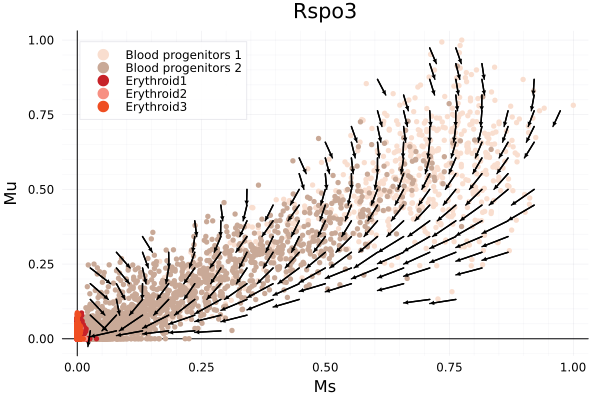

In [27]:
p2 = plot()
for label in labels
    scatter!(X[2, celltype .== label, idx2], X[1, celltype .== label, idx2], label = label, xlabel = "Ms", ylabel = "Mu", title = "Rspo3", color = palattes[label])
end
quiver!(point_vector1[:, 1], point_vector1[:, 2], quiver = (arrow_vector1[:, 1], arrow_vector1[:, 2]), arrow = arrow(:closed), color = "#000000")

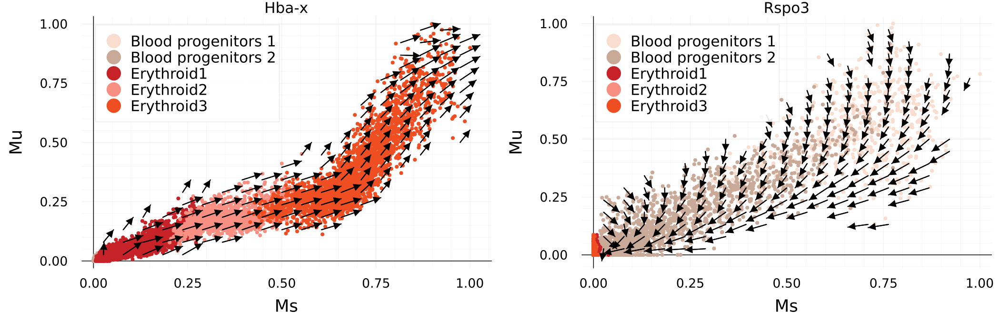

In [28]:
p = plot(p1, p2, layout = (1, 2), size = (1400, 450), dpi = 150, left_margins = 1.0Plots.cm, bottom_margins = 1.0Plots.cm, legendfontsize = 14
    , xtickfontsize = 12, ytickfontsize = 12, xguidefontsize = 16, yguidefontsize = 16)

In [29]:
savefig(p, "figure/JuloVelo_velocity_vector.png")

"/media/data/bmi111/KuanChiun/JuloVelo/thesis/results/erythroid/figure/JuloVelo_velocity_vector.png"

## Trasncriptional rate

In [30]:
kinetics = adata.uns["kinetics"];

In [31]:
α = kinetics[1, :, :] .* 2 ;

In [32]:
p3 = scatter(X[2, :, idx], X[1, :, idx], zcolor = α[:, idx], xlabel = "Ms", ylabel = "Mu", xtickfontsize = 12, ytickfontsize = 12, xguidefontsize = 16, yguidefontsize = 16, title = "Hba-x", clims = (0, 1.0), label = nothing);

In [33]:
p4 = scatter(X[2, :, idx2], X[1, :, idx2], zcolor = α[:, idx2], xlabel = "Ms", ylabel = "Mu", xtickfontsize = 12, ytickfontsize = 12, xguidefontsize = 16, yguidefontsize = 16, title = "Rspo3", clims = (0, 1.0), label = nothing);

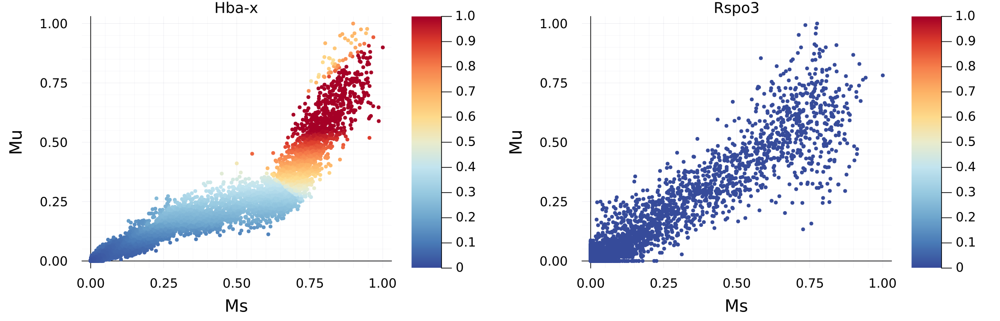

In [34]:
p = plot(p3, p4, layout = (1, 2), size = (1400, 450), dpi = 150, left_margins = 1.0Plots.cm, bottom_margins = 1.0Plots.cm, legendfontsize = 12)

In [35]:
savefig(p, "figure/JuloVelo_alpha.png")

"/media/data/bmi111/KuanChiun/JuloVelo/thesis/results/erythroid/figure/JuloVelo_alpha.png"

# Kinetics embedding

In [36]:
kinetics_embedding(adata);

In [37]:
embedding = adata.obsm["kinetics_pca"];

In [38]:
celltype = adata.obs[!, "celltype"]
labels = sort(unique(celltype))

5-element Vector{String}:
 "Blood progenitors 1"
 "Blood progenitors 2"
 "Erythroid1"
 "Erythroid2"
 "Erythroid3"

In [39]:
theme(:vibrant, framestyle = :axes, grid = true, markersize = 3, linewidth = 1.4, palette = :tab20) 

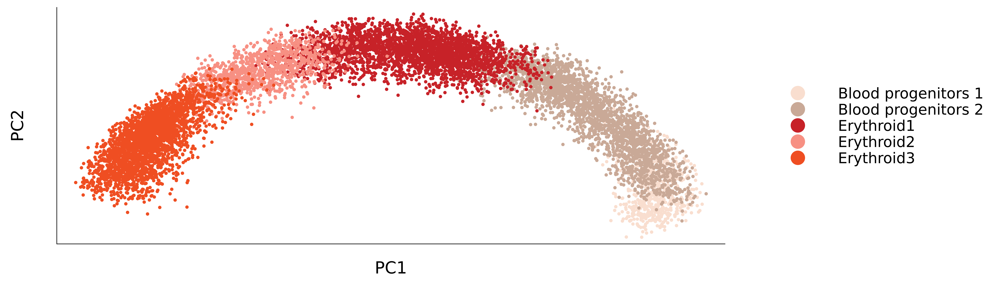

In [40]:
p = scatter(size = (1600, 450), fg_legend = :transparent, left_margin = 1.8Plots.cm, bottom_margin = 1.0Plots.cm, dpi = 300) #
for label in labels
    scatter!(embedding[celltype .== label, 1], embedding[celltype .== label, 2], label = label, legend=:outerright, legendfontsize = 16, color = palattes[label]
        , xlabel = "PC1", ylabel = "PC2", xtick = nothing, yticks = nothing, xguidefontsize = 18, yguidefontsize = 18)
end
p

In [41]:
savefig(p, "figure/erythroid_kinetic_embedding.png")

"/media/data/bmi111/KuanChiun/JuloVelo/thesis/results/erythroid/figure/erythroid_kinetic_embedding.png"